In [ ]:
# set tf 1.x for colab
%tensorflow_version 1.x

# Image Captioning Final Project

In this final project you will define and train an image-to-caption model, that can produce descriptions for real world images!

<img src="images/encoder_decoder.png" style="width:70%">

Model architecture: CNN encoder and RNN decoder. 
(https://research.googleblog.com/2014/11/a-picture-is-worth-thousand-coherent.html)

# Import stuff

In [1]:
import sys
sys.path.append("..")
import grading
import download_utils

In [2]:
download_utils.link_all_keras_resources()

In [3]:
import tensorflow as tf
from tensorflow.contrib import keras
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
L = keras.layers
K = keras.backend
import utils
import time
import zipfile
import json
from collections import defaultdict
import re
import random
from random import choice
import grading_utils
import os
from keras_utils import reset_tf_session
import tqdm_utils

Using TensorFlow backend.


# Prepare the storage for model checkpoints

In [4]:
# Leave USE_GOOGLE_DRIVE = False if you're running locally!
# We recommend to set USE_GOOGLE_DRIVE = True in Google Colab!
# If set to True, we will mount Google Drive, so that you can restore your checkpoint 
# and continue trainig even if your previous Colab session dies.
# If set to True, follow on-screen instructions to access Google Drive (you must have a Google account).
USE_GOOGLE_DRIVE = False

def mount_google_drive():
    from google.colab import drive
    mount_directory = "/content/gdrive"
    drive.mount(mount_directory)
    drive_root = mount_directory + "/" + list(filter(lambda x: x[0] != '.', os.listdir(mount_directory)))[0] + "/colab"
    return drive_root

CHECKPOINT_ROOT = ""
if USE_GOOGLE_DRIVE:
    CHECKPOINT_ROOT = mount_google_drive() + "/"

def get_checkpoint_path(epoch=None):
    if epoch is None:
        return os.path.abspath(CHECKPOINT_ROOT + "weights")
    else:
        return os.path.abspath(CHECKPOINT_ROOT + "weights_{}".format(epoch))
      
# example of checkpoint dir
print(get_checkpoint_path(10))

/root/intro_to_dl/week6/weights_10


# Fill in your Coursera token and email
To successfully submit your answers to our grader, please fill in your Coursera submission token and email

In [44]:
grader = grading.Grader(assignment_key="NEDBg6CgEee8nQ6uE8a7OA", 
                        all_parts=["19Wpv", "uJh73", "yiJkt", "rbpnH", "E2OIL", "YJR7z"])

In [45]:
# token expires every 30 min
COURSERA_TOKEN = 'TGQCFiVlJDYoOsbb'
COURSERA_EMAIL = 'mascomen4@gmail.com'

# Download data

Takes 10 hours and 20 GB. We've downloaded necessary files for you.

Relevant links (just in case):
- train images http://msvocds.blob.core.windows.net/coco2014/train2014.zip
- validation images http://msvocds.blob.core.windows.net/coco2014/val2014.zip
- captions for both train and validation http://msvocds.blob.core.windows.net/annotations-1-0-3/captions_train-val2014.zip

In [5]:
# we downloaded them for you, just link them here
download_utils.link_week_6_resources()

# Extract image features

We will use pre-trained InceptionV3 model for CNN encoder (https://research.googleblog.com/2016/03/train-your-own-image-classifier-with.html) and extract its last hidden layer as an embedding:

<img src="images/inceptionv3.png" style="width:70%">

In [6]:
IMG_SIZE = 299

In [7]:
def get_cnn_encoder():
    K.set_learning_phase(False) # not training
    model = keras.applications.InceptionV3(include_top=False) # disable fully connected layer
    preprocess_for_model = keras.applications.inception_v3.preprocess_input 

    # GlobalAveragePooling2D is converting n 2 dimensional feature maps into the vector of length n, by
    # averaging it 
    model = keras.models.Model(inputs=model.inputs, outputs=keras.layers.GlobalAveragePooling2D()(model.output))
    return model, preprocess_for_model

In [10]:
# Training the CNN model on the dataset.

Features extraction takes too much time on CPU:
- Takes 16 minutes on GPU.
- 25x slower (InceptionV3) on CPU and takes 7 hours.
- 10x slower (MobileNet) on CPU and takes 3 hours.

So we've done it for you with the following code:
```python
# load pre-trained model
reset_tf_session()
encoder, preprocess_for_model = get_cnn_encoder()

# extract train features
train_img_embeds, train_img_fns = utils.apply_model(
    "train2014.zip", encoder, preprocess_for_model, input_shape=(IMG_SIZE, IMG_SIZE))
utils.save_pickle(train_img_embeds, "train_img_embeds.pickle")
utils.save_pickle(train_img_fns, "train_img_fns.pickle")

# extract validation features
val_img_embeds, val_img_fns = utils.apply_model(
    "val2014.zip", encoder, preprocess_for_model, input_shape=(IMG_SIZE, IMG_SIZE))
utils.save_pickle(val_img_embeds, "val_img_embeds.pickle")
utils.save_pickle(val_img_fns, "val_img_fns.pickle")

# sample images for learners
def sample_zip(fn_in, fn_out, rate=0.01, seed=42):
    np.random.seed(seed)
    with zipfile.ZipFile(fn_in) as fin, zipfile.ZipFile(fn_out, "w") as fout:
        sampled = filter(lambda _: np.random.rand() < rate, fin.filelist)
        for zInfo in sampled:
            fout.writestr(zInfo, fin.read(zInfo))
            
sample_zip("train2014.zip", "train2014_sample.zip")
sample_zip("val2014.zip", "val2014_sample.zip")
```

In [8]:
# load prepared embeddings
train_img_embeds = utils.read_pickle("train_img_embeds.pickle")
train_img_fns = utils.read_pickle("train_img_fns.pickle") # traing img filenames
val_img_embeds = utils.read_pickle("val_img_embeds.pickle")
val_img_fns = utils.read_pickle("val_img_fns.pickle") # val img filenames
# check shapes
print(train_img_embeds.shape, len(train_img_fns))
print(val_img_embeds.shape, len(val_img_fns))

(82783, 2048) 82783
(40504, 2048) 40504


In [9]:
# check prepared samples of images
list(filter(lambda x: x.endswith("_sample.zip"), os.listdir(".")))

['train2014_sample.zip', 'val2014_sample.zip']

# Extract captions for images

In [10]:
# extract captions from zip
def get_captions_for_fns(fns, zip_fn, zip_json_path):
    zf = zipfile.ZipFile(zip_fn)
    j = json.loads(zf.read(zip_json_path).decode("utf8"))
    id_to_fn = {img["id"]: img["file_name"] for img in j["images"]}
    fn_to_caps = defaultdict(list)
    for cap in j['annotations']:
        fn_to_caps[id_to_fn[cap['image_id']]].append(cap['caption'])
    fn_to_caps = dict(fn_to_caps)
    return list(map(lambda x: fn_to_caps[x], fns))
    
train_captions = get_captions_for_fns(train_img_fns, "captions_train-val2014.zip", 
                                      "annotations/captions_train2014.json")

val_captions = get_captions_for_fns(val_img_fns, "captions_train-val2014.zip", 
                                      "annotations/captions_val2014.json")

# check shape
print(len(train_img_fns), len(train_captions))
print(len(val_img_fns), len(val_captions))

82783 82783
40504 40504


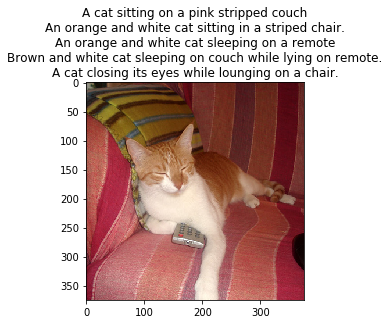

In [11]:
# look at training example (each has 5 captions)
def show_training_example(train_img_fns, train_captions, example_idx=0):
    """
    You can change example_idx and see different images
    """
    zf = zipfile.ZipFile("train2014_sample.zip")
    captions_by_file = dict(zip(train_img_fns, train_captions))
    all_files = set(train_img_fns)
    # choose the last item after split. 
    found_files = list(filter(lambda x: x.filename.rsplit("/")[-1] in all_files, zf.filelist))
    example = found_files[example_idx]
    # decode the image from buf.  
    img = utils.decode_image_from_buf(zf.read(example))
    plt.imshow(utils.image_center_crop(img))
    plt.title("\n".join(captions_by_file[example.filename.rsplit("/")[-1]]))
    plt.show()
    
show_training_example(train_img_fns, train_captions, example_idx=142)

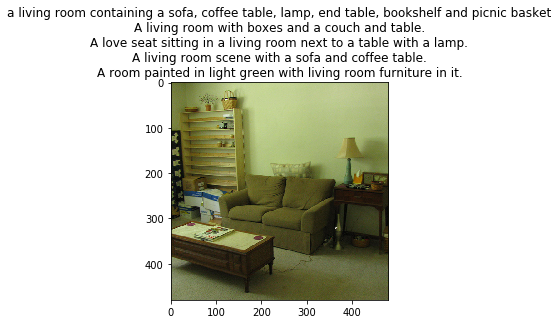

In [12]:
show_training_example(train_img_fns, train_captions, 1)

# Prepare captions for training

In [13]:
# preview captions data
train_captions[:2]

[['A long dirt road going through a forest.',
  'A SCENE OF WATER AND A PATH WAY',
  'A sandy path surrounded by trees leads to a beach.',
  'Ocean view through a dirt road surrounded by a forested area. ',
  'dirt path leading beneath barren trees to open plains'],
 ['A group of zebra standing next to each other.',
  'This is an image of of zebras drinking',
  'ZEBRAS AND BIRDS SHARING THE SAME WATERING HOLE',
  'Zebras that are bent over and drinking water together.',
  'a number of zebras drinking water near one another']]

In [14]:
# special tokens
PAD = "#PAD#"
UNK = "#UNK#"
START = "#START#"
END = "#END#"

# split sentence into tokens (split into lowercased words)
def split_sentence(sentence):
    return list(filter(lambda x: len(x) > 0, re.split('\W+', sentence.lower())))

# TODO: The naive approach to these captions is quite unefficient. Think about how you can improve this 
# algorithm.
def generate_vocabulary(train_captions):
    """
    Return {token: index} for all train tokens (words) that occur 5 times or more, 
        `index` should be from 0 to N, where N is a number of unique tokens in the resulting dictionary.
    Use `split_sentence` function to split sentence into tokens.
    Also, add PAD (for batch padding), UNK (unknown, out of vocabulary), 
        START (start of sentence) and END (end of sentence) tokens into the vocabulary.
    """
    vocab = []
    entries_vocab = dict()
    
    for caption in train_captions:
        for sentence in caption:
            tokens = split_sentence(sentence)
            for token in tokens:
                try:
                    entries_vocab[token] += 1
                except:
                    entries_vocab[token] = 1
    
    entries_vocab = {token: count for token, count in entries_vocab.items() if count > 4}
    vocab = list(entries_vocab.keys())
    
    utils_tokens = [PAD, UNK, START, END]
    vocab += utils_tokens
            
    return {token: index for index, token in enumerate(sorted(vocab))}
    
def caption_tokens_to_indices(captions, vocab):
    # image 1 caption1 is just a notation. caption1 represents a first sentence in the image captions. 
    # len(captions)=number of images; len(captions[i])=number of captions for each image.
    """
    `captions` argument is an array of arrays:
    [
        [
            "image1 caption1",
            "image1 caption2",
            ...
        ],
        [
            "image2 caption1",
            "image2 caption2",
            ...
        ],
        ...
    ]
    Use `split_sentence` function to split sentence into tokens.
    Replace all tokens with vocabulary indices, use UNK for unknown words (out of vocabulary).
    Add START and END tokens to start and end of each sentence respectively.
    For the example above you should produce the following:
    [
        [
            [vocab[START], vocab["image1"], vocab["caption1"], vocab[END]],
            [vocab[START], vocab["image1"], vocab["caption2"], vocab[END]],
            ...
        ],
        ...
    ]
    """
    res = []
    for caption in captions:
        img_captions = []
        for sentence in caption:
            sentence_list = [vocab[START]]
            splitted_sentence = split_sentence(sentence)
            for word in splitted_sentence:
                try:
                    sentence_list.append(vocab[word])
                except KeyError:
                    sentence_list.append(vocab[UNK])
            sentence_list.append(vocab[END])
            
            img_captions.append(sentence_list)
        res.append(img_captions)        
                
    return res

In [15]:
# prepare vocabulary
vocab = generate_vocabulary(train_captions)
vocab_inverse = {idx: w for w, idx in vocab.items()}
print(len(vocab))

8769


In [16]:
# replace tokens with indices
train_captions_indexed = caption_tokens_to_indices(train_captions, vocab)
val_captions_indexed = caption_tokens_to_indices(val_captions, vocab)

In [17]:
len(train_captions_indexed)

82783

In [18]:
len(val_captions_indexed)

40504

Captions have different length, but we need to batch them, that's why we will add PAD tokens so that all sentences have an equal length. 

We will crunch LSTM through all the tokens, but we will ignore padding tokens during loss calculation.

In [19]:
# we will use this during training
def batch_captions_to_matrix(batch_captions, pad_idx, max_len=None):
    """
    The input is already consists of the idxs
    
    `batch_captions` is an array of arrays:
    [
        [vocab[START], ..., vocab[END]],
        [vocab[START], ..., vocab[END]],
        ...
    ]
    Put vocabulary indexed captions into np.array of shape (len(batch_captions), columns),
        where "columns" is max(map(len, batch_captions)) when max_len is None
        and "columns" = min(max_len, max(map(len, batch_captions))) otherwise.
    Add padding with pad_idx where necessary.
    Input example: [[1, 2, 3], [4, 5]]
    Output example: np.array([[1, 2, 3], [4, 5, pad_idx]]) if max_len=None
    Output example: np.array([[1, 2], [4, 5]]) if max_len=2
    Output example: np.array([[1, 2, 3], [4, 5, pad_idx]]) if max_len=100
    Try to use numpy, we need this function to be fast!
    """
    # TODO: Implement array equation using numpy. The idea is the following: create a numpy array that is zeros 
    # of shape [batch_size, columns], then fill values with the batch_captions. 
    # TODO: Add multiprocessing
    matrix = np.array([], dtype='int32')
    columns = max(map(len, batch_captions)) if max_len is None else min(max_len, max(map(len, batch_captions))) 
    for index, caption in enumerate(batch_captions):
        # I can try to turn the caption into np array iniliazited with the ones. Then, using slicing, fill 
        # the first n entrances with the caption.
        caption_output = np.zeros(columns, dtype="int32")
        
        len_caption = len(caption)
        cap_slice = columns if columns < len_caption else len_caption
        caption_output[:cap_slice] = caption[:cap_slice]
        caption_output[cap_slice:] = pad_idx
        try:
            matrix = np.vstack([matrix, caption_output])
        except ValueError:
            matrix = np.append(matrix, caption_output)
    return matrix

In [20]:
''' 
Test cases:
    Input example: [[1, 2, 3], [4, 5]]
    Output example: np.array([[1, 2, 3], [4, 5, pad_idx]]) if max_len=None
    Output example: np.array([[1, 2], [4, 5]]) if max_len=2
    Output example: np.array([[1, 2, 3], [4, 5, pad_idx]]) if max_len=100
'''
batch_captions = [[1, 2, 3], [4, 5]]
pad_idx = vocab[PAD]

# Test case 1
matrix = batch_captions_to_matrix(batch_captions, pad_idx)
print("Test case 1: \n {}".format(matrix), end="\n\n")

# Test case 2
matrix = batch_captions_to_matrix(batch_captions, pad_idx, 2)
print("Test case 2: \n {}".format(matrix), end="\n\n")

# Test case 3
matrix = batch_captions_to_matrix(batch_captions, pad_idx, 100)
print("Test case 3: \n {}".format(matrix), end="\n\n")


Test case 1: 
 [[1 2 3]
 [4 5 1]]

Test case 2: 
 [[1 2]
 [4 5]]

Test case 3: 
 [[1 2 3]
 [4 5 1]]



In [48]:
## GRADED PART, DO NOT CHANGE!
# Vocabulary creation
grader.set_answer("19Wpv", grading_utils.test_vocab(vocab, PAD, UNK, START, END))
# Captions indexing
grader.set_answer("uJh73", grading_utils.test_captions_indexing(train_captions_indexed, vocab, UNK))
# Captions batching
grader.set_answer("yiJkt", grading_utils.test_captions_batching(batch_captions_to_matrix))

In [49]:
# you can make submission with answers so far to check yourself at this stage
grader.submit(COURSERA_EMAIL, COURSERA_TOKEN)

ConnectionError: HTTPSConnectionPool(host='www.coursera.org', port=443): Max retries exceeded with url: /api/onDemandProgrammingScriptSubmissions.v1 (Caused by NewConnectionError('<urllib3.connection.HTTPSConnection object at 0x7f54684c72b0>: Failed to establish a new connection: [Errno -3] Temporary failure in name resolution',))

In [25]:
# make sure you use correct argument in caption_tokens_to_indices
assert len(caption_tokens_to_indices(train_captions[:10], vocab)) == 10
assert len(caption_tokens_to_indices(train_captions[:5], vocab)) == 5

# Training

## Define architecture

Since our problem is to generate image captions, RNN text generator should be conditioned on image. The idea is to use image features as an initial state for RNN instead of zeros. 

Remember that you should transform image feature vector to RNN hidden state size by fully-connected layer and then pass it to RNN.

During training we will feed ground truth tokens into the lstm to get predictions of next tokens. 

Notice that we don't need to feed last token (END) as input (http://cs.stanford.edu/people/karpathy/):

<img src="images/encoder_decoder_explained.png" style="width:50%">

In [21]:
# The output of the CNN is a vector of length n. Then after MLP this vector results in some vector of length m. 


# If we feed the ground truth inputs to the network, how do we estimate the error? How does this network is 
# training

IMG_EMBED_SIZE = train_img_embeds.shape[1]
IMG_EMBED_BOTTLENECK = 120
WORD_EMBED_SIZE = 100
LSTM_UNITS = 300
LOGIT_BOTTLENECK = 120
pad_idx = vocab[PAD]

In [134]:
# remember to reset your graph if you want to start building it from scratch!
s = reset_tf_session()
# why to set rando|m seed in tf? 
tf.set_random_seed(42)

Here we define decoder graph.

We use Keras layers where possible because we can use them in functional style with weights reuse like this:
```python
dense_layer = L.Dense(42, input_shape=(None, 100) activation='relu')
a = tf.placeholder('float32', [None, 100])
b = tf.placeholder('float32', [None, 100])
dense_layer(a)  # that's how we applied dense layer!
dense_layer(b)  # and again
```

In [116]:
# Decoder is a RNN or the MLP that converts GlobalAvgPooling result in the appropriate result for RNN?

Here's a figure to help you with flattening in decoder:
<img src="images/flatten_help.jpg" style="width:80%">

In [117]:
# "example" is just a one sentence from the set of captions for particular image.

# '''
# flat_hidden_states dimensionality: [time_steps*batch_size, LSTM_UNITS]
# token_logits_bottleneck dimensionality: [time_steps*batch_size, LOGIT_BOTTLENECK]
# token_logits dimensionality: [time_steps*batch_size, len(vocab)]
# '''

# QUESTIONS:
# 1. Why do we need to flatten the states? [answered, see answer 3]
# 2. What is happening when we apply dense layers to flattened_hidden_states? [answered, see answer 1]
# 3. What is the result of multiplying a row by a matrix? [answered, see answer 1]
# 4. What are LSTM_UNITS in the scheme above? [answered, see answer 2]
# 5. Can I see an unfolded diagram of LSTM with units? Is it just an MLP inside the LSTM cell?
# Take a closer look at the lectures.


# ANSWERS:
# 1. The output of the scheme above is just a probability distribution for each token for each time step
# for each batch. It was obtained by using the MLP with LOGIT_BOTTLENECK=120 units.
# 2. LSTM_UNITS is the number of functions inside hidden state at time step t. 
# 3. This is just a way to compute the probabilites of sentences

In [118]:
# reset_tf_session()
# tf.set_random_seed(42)

In [135]:
class decoder:
    # [batch_size, IMG_EMBED_SIZE] of CNN image features
    img_embeds = tf.placeholder('float32', [None, IMG_EMBED_SIZE])
    # [batch_size, time steps] of word ids
    sentences = tf.placeholder('int32', [None, None])
    
    # we use bottleneck here to reduce the number of parameters
    # image embedding -> bottleneck
    img_embed_to_bottleneck = L.Dense(units=IMG_EMBED_BOTTLENECK, 
                                      input_shape=(None, IMG_EMBED_SIZE), 
                                      activation='elu')
    # image embedding bottleneck -> lstm initial state
    img_embed_bottleneck_to_h0 = L.Dense(units=LSTM_UNITS,
                                         input_shape=(None, IMG_EMBED_BOTTLENECK),
                                         activation='elu')
    # word -> embedding
    word_embed = L.Embedding(len(vocab), WORD_EMBED_SIZE)
    # lstm cell (from tensorflow)
    lstm = tf.nn.rnn_cell.LSTMCell(LSTM_UNITS)
    
    # we use bottleneck here to reduce model complexity
    # lstm output -> logits bottleneck
    token_logits_bottleneck = L.Dense(units=LOGIT_BOTTLENECK, 
                                      input_shape=(None, LSTM_UNITS),
                                      activation="elu")
    # logits bottleneck -> logits for next token prediction
    token_logits = L.Dense(len(vocab),
                           input_shape=(None, LOGIT_BOTTLENECK))
    
    # initial lstm cell state of shape (None, LSTM_UNITS),
    # we need to condition it on `img_embeds` placeholder.
    c0 = h0 = img_embed_bottleneck_to_h0(img_embed_to_bottleneck(img_embeds))

    # embed all tokens but the last for lstm input,
    # remember that L.Embedding is callable,
    # use `sentences` placeholder as input.
    word_embeds = word_embed(sentences[:, :-1])
    
    # during training we use ground truth tokens `word_embeds` as context for next token prediction.
    # that means that we know all the inputs for our lstm and can get 
    # all the hidden states with one tensorflow operation (tf.nn.dynamic_rnn).
    # `hidden_states` has a shape of [batch_size, time steps, LSTM_UNITS].
    hidden_states, _ = tf.nn.dynamic_rnn(cell=lstm, inputs=word_embeds,
                                         initial_state=tf.nn.rnn_cell.LSTMStateTuple(c0, h0))
    print("hidden states", hidden_states)
    print("dynamic_rnn output", tf.nn.dynamic_rnn(cell=lstm, inputs=word_embeds,
                                         initial_state=tf.nn.rnn_cell.LSTMStateTuple(c0, h0)))

    # now we need to calculate token logits for all the hidden states
    
    # first, we reshape `hidden_states` to [-1, LSTM_UNITS]
    flat_hidden_states = tf.reshape(hidden_states, [-1, LSTM_UNITS])

    # then, we calculate logits for next tokens using `token_logits_bottleneck` and `token_logits` layers
    flat_token_logits_bottleneck = token_logits_bottleneck(flat_hidden_states)
    flat_token_logits = token_logits(flat_token_logits_bottleneck)
    
    # then, we flatten the ground truth token ids.
    # remember, that we predict next tokens for each time step,
    # use `sentences` placeholder.
    # flat_ground_truth has approx. the following structure: [1, 2, 3, 1, 1, 3, 5, 7]
    flat_ground_truth = tf.reshape(sentences[:,1:], [-1])

    # we need to know where we have real tokens (not padding) in `flat_ground_truth`,
    # we don't want to propagate the loss for padded output tokens,
    # fill `flat_loss_mask` with 1.0 for real tokens (not pad_idx) and 0.0 otherwise.

    pad_idx = vocab[PAD]
    # tf.shape equals to dimensionality of the tensor.
    flat_loss_mask = tf.cast(tf.not_equal(flat_ground_truth, pad_idx), dtype='float32')

    # compute cross-entropy between `flat_ground_truth` and `flat_token_logits` predicted by lstm
    # sparse_softmax_cross_entropy_with_logits unfolds the labels for me. 
    xent = tf.nn.sparse_softmax_cross_entropy_with_logits(
        labels=flat_ground_truth, 
        logits=flat_token_logits
    )

    # compute average `xent` over tokens with nonzero `flat_loss_mask`.
    # we don't want to account misclassification of PAD tokens, because that doesn't make sense,
    # we have PAD tokens for batching purposes only!
    
    mask = tf.cast(flat_loss_mask, bool)
    #mask = tf.reshape(tf.where(mask), [-1])
    print(mask.shape)
    masked_xent = tf.boolean_mask(xent, mask)
    loss = tf.reduce_mean(masked_xent)
#     print("mask shape", mask.shape, mask.dtype, mask)
#     print("xent shape", xent.shape, xent.dtype, xent)
    
    #loss = tf.reduce_mean(tf.boolean_mask(xent, tf.equal(flat_loss_mask, 1.0)))

hidden states Tensor("rnn/transpose:0", shape=(?, ?, 300), dtype=float32)
dynamic_rnn output (<tf.Tensor 'rnn_1/transpose:0' shape=(?, ?, 300) dtype=float32>, LSTMStateTuple(c=<tf.Tensor 'rnn_1/while/Exit_2:0' shape=(?, 300) dtype=float32>, h=<tf.Tensor 'rnn_1/while/Exit_3:0' shape=(?, 300) dtype=float32>))
(?,)


In [136]:
# QUESTIONS:
# 1. How is the scheme above applied in the code above?
# 2. What should h0, c0 consist of? 
# 3. Recall the formula of cross-entropy
# 4. What is the ouput of the embedding layer? 
# 5. Why to embed all tokens but the last, and if so, what should I do to make it coherent with the next code? 


# ANSWERS:
# 1. So, we first define the architechture of the net using functional Keras API, then we flatten the outputs? 
# of the network to compute for words for each batch.
# 2. h0 should consist of the image embeddings from CNN
# 3. ?
# 4. ?
# 5. Because according to karpathy research, we don't use the END token. Take a closer look why.# 5. 


In [137]:
# define optimizer operation to minimize the loss
optimizer = tf.train.AdamOptimizer(learning_rate=0.001)
train_step = optimizer.minimize(decoder.loss)

# will be used to save/load network weights.
# you need to reset your default graph and define it in the same way to be able to load the saved weights!
saver = tf.train.Saver()

# intialize all variables
s.run(tf.global_variables_initializer())

/usr/local/lib/python3.5/dist-packages/tensorflow/python/ops/gradients_impl.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


In [83]:
## GRADED PART, DO NOT CHANGE!
# Decoder shapes test
grader.set_answer("rbpnH", grading_utils.test_decoder_shapes(decoder, IMG_EMBED_SIZE, vocab, s))
# Decoder random loss test
grader.set_answer("E2OIL", grading_utils.test_random_decoder_loss(decoder, IMG_EMBED_SIZE, vocab, s))

In [296]:
# you can make submission with answers so far to check yourself at this stage
grader.submit(COURSERA_EMAIL, COURSERA_TOKEN)

Submitted to Coursera platform. See results on assignment page!


## Training loop
Evaluate train and validation metrics through training and log them. Ensure that loss decreases.

In [108]:
# A little nasty error: numpy does not convert to numpy array nested list of different length. 
# So I wrote a function that makes them equal. It fills that with pad_idx.

# def equalize_nested_list(array):
#     equalized_list = []
#     columns = 0
#     for image in array:
#         max_col = max(map(len, image))
#         if max_col > columns:
#             columns = max_col
            
#     for image in array:
#         img_caption = []
#         for caption in image:
#             while len(caption) < columns:
#                 caption.append(pad_idx)
#             img_caption.append(caption)
#         equalized_list.append(img_caption)
#     return equalized_list

# train_captions_indexed = equalize_nested_list(train_captions_indexed)
# val_captions_indexed = equalize_nested_list(val_captions_indexed)


# train_captions_indexed = np.concatenate(train_captions_indexed)
# val_captions_indexed = np.concatenate(val_captions_indexed)

# for img in train_captions_indexed:
#     if len(img) != 5:
#         print("Oops, looks like it's not five, it's length is {}".format(len(img)))
#         print(img)
#     for caption in img:
#         if len(caption) != 52:
#             print("Oops, looks like it's not 18, it's length is {}".format(len(caption)))

# for img in train_captions_indexed:
#     for caption in img:
#         for word in caption:
#             if type(word) is not int:
#                 print(word)

In [138]:
train_captions_indexed = np.array(train_captions_indexed)
val_captions_indexed = np.array(val_captions_indexed)

In [139]:
# generate batch via random sampling of images and captions for them,
# we use `max_len` parameter to control the length of the captions (truncating long captions)
def generate_batch(images_embeddings, indexed_captions, batch_size, max_len=None):
    # I need to take into consideration the random choice of the caption. So I need somehow
    # Ok, I'll treat to the input as to the python list, not the numpy array. But I can add the treatment as 
    # to as a numpy array if the type of the input is "int32"
    """
    `images_embeddings` is a np.array of shape [number of images, IMG_EMBED_SIZE].
    `indexed_captions` holds 5 vocabulary indexed captions for each image
    `and has a shape of [number of images, 5, sentence length]:
    [
        [
            [vocab[START], vocab["image1"], vocab["caption1"], vocab[END]],
            [vocab[START], vocab["image1"], vocab["caption2"], vocab[END]],
            ...
        ],
        ...
    ]
    Generate a random batch of size `batch_size`.
    Take random images and choose one random caption for each image.
    Remember to use `batch_captions_to_matrix` for padding and respect `max_len` parameter.
    Return feed dict {decoder.img_embeds: ..., decoder.sentences: ...}.
    """
    batch_choice = np.random.randint(0, len(images_embeddings), batch_size)
    # print(img_choice)
    batch_image_embeddings = images_embeddings[batch_choice]
#     print("Shape of batch_image_embeddings: ", batch_image_embeddings.shape)
    
    # TODO: Change the captions_number to list, so that it will be unique for each image (there are images that 
    # have more than 5 captions.)
    batch_indexed_captions = indexed_captions[batch_choice]
    batch_indexed_captions_output = []
    
    for captions in batch_indexed_captions:
        caption_choice = np.random.randint(0, len(captions) - 1)
#         print("Caption choice: ", captions[caption_choice])
        batch_indexed_captions_output.append(captions[caption_choice])
    
    batch_indexed_captions_output = np.array(batch_indexed_captions_output)
    # Now batch_indexed_caption_output has the appropriate shape for input to batch_captions_to_matrix
#     print("Dtype of the batch_indexed_captions_output is: {}".format(batch_indexed_captions_output.dtype))
#     print("Two examples from bico: {}".format(batch_indexed_captions_output[:2]))
    
    captions_choice = batch_captions_to_matrix(batch_indexed_captions_output, pad_idx, max_len)
    
    batch_captions_matrix = captions_choice
#     print("Batch captions matrix type: ", batch_captions_matrix.dtype)
#     print("batch_captions_matrix: ", batch_captions_matrix[:2])
#     print("Shape of batch_captions_matrix: ", batch_captions_matrix.shape)
    
    return {decoder.img_embeds: batch_image_embeddings, 
            decoder.sentences: batch_captions_matrix}


def generate_batch_of_first_64_imgs(images_embeddings, indexed_captions, batch_size, max_len=None):
    """
    Generates the batch of first 64 imgs.
    """
    batch_choice = np.arange(8, 72)
    batch_image_embeddings = images_embeddings[batch_choice]

    batch_indexed_captions = indexed_captions[batch_choice]
    batch_indexed_captions_output = []
    
    for captions in batch_indexed_captions:
        caption_choice = np.random.randint(0, len(captions) - 1)
        batch_indexed_captions_output.append(captions[caption_choice])
    
    batch_indexed_captions_output = np.array(batch_indexed_captions_output)
    
    captions_choice = batch_captions_to_matrix(batch_indexed_captions_output, pad_idx, max_len)
    
    batch_captions_matrix = captions_choice
    
    return {decoder.img_embeds: batch_image_embeddings, 
            decoder.sentences: batch_captions_matrix}

In [140]:
batch_size = 64
n_epochs = 8
n_batches_per_epoch = 1000
n_validation_batches = 100  # how many batches are used for validation after each epoch

In [141]:
# you can load trained weights here
# uncomment the next line if you need to load weights
#saver.restore(s, get_checkpoint_path())

Look at the training and validation loss, they should be decreasing!

In [142]:
# actual training loop
MAX_LEN = 20  # truncate long captions to speed up training

# to make training reproducible
np.random.seed(42)
random.seed(42)
train_loss_list = []
val_loss_list = []

for epoch in range(n_epochs):
    
    train_loss = 0
    pbar = tqdm_utils.tqdm_notebook_failsafe(range(n_batches_per_epoch))
    counter = 0
    for _ in pbar:
        # What does s.run return? 
        s_result = s.run([decoder.loss, train_step, decoder.xent, decoder.masked_xent], 
                            generate_batch(train_img_embeds, 
                                           train_captions_indexed, 
                                           batch_size, 
                                           MAX_LEN))
        train_loss += s_result[0]
        counter += 1
        # Why to divide it by counter? So, from loss it's the mean over 64 batch elements. And we divide it 
        # by the number of iterations
        # Answer: this is because we sum up the avg losses at each batch, and then just take the mean of that.
        train_loss_list.append(train_loss)
        pbar.set_description("Training loss: %f" % (train_loss / counter))
    
    train_loss /= n_batches_per_epoch
    
    val_loss = 0
    for _ in range(n_validation_batches):
        val_loss += s.run(decoder.loss, generate_batch(val_img_embeds,
                                                       val_captions_indexed, 
                                                       batch_size, 
                                                       MAX_LEN))
        val_loss_list.append(val_loss)
    val_loss /= n_validation_batches
    
    print('Epoch: {}, train loss: {}, val loss: {}'.format(epoch, train_loss, val_loss))

    # save weights after finishing epoch
    saver.save(s, get_checkpoint_path(epoch))
    
print("Finished!")

  0%|          | 0/1000 [00:00<?, ?it/s]

Epoch: 0, train loss: 4.318377292156219, val loss: 3.6333496260643003


  0%|          | 0/1000 [00:00<?, ?it/s]

Epoch: 1, train loss: 3.3233394901752473, val loss: 3.161390676498413


  0%|          | 0/1000 [00:00<?, ?it/s]

Epoch: 2, train loss: 3.014095538854599, val loss: 2.9883607029914856


  0%|          | 0/1000 [00:00<?, ?it/s]

Epoch: 3, train loss: 2.8721006252765657, val loss: 2.872296872138977


  0%|          | 0/1000 [00:00<?, ?it/s]

Epoch: 4, train loss: 2.780136414051056, val loss: 2.802024939060211


  0%|          | 0/1000 [00:00<?, ?it/s]

Epoch: 5, train loss: 2.7082896687984466, val loss: 2.7598544573783874


  0%|          | 0/1000 [00:00<?, ?it/s]

Epoch: 6, train loss: 2.6626444072723388, val loss: 2.7340672969818116


  0%|          | 0/1000 [00:00<?, ?it/s]

Epoch: 7, train loss: 2.616600708246231, val loss: 2.690811769962311
Finished!


In [46]:
## GRADED PART, DO NOT CHANGE!
# Validation loss
grader.set_answer("YJR7z", grading_utils.test_validation_loss(
    decoder, s, generate_batch, val_img_embeds, val_captions_indexed))

  0%|          | 0/1000 [00:00<?, ?it/s]

In [210]:
# you can make submission with answers so far to check yourself at this stage
grader.submit(COURSERA_EMAIL, COURSERA_TOKEN)

Submitted to Coursera platform. See results on assignment page!


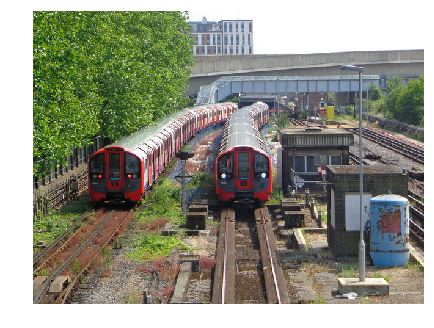

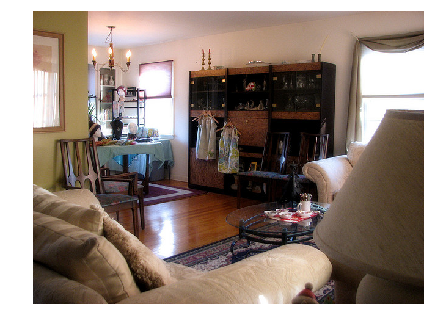

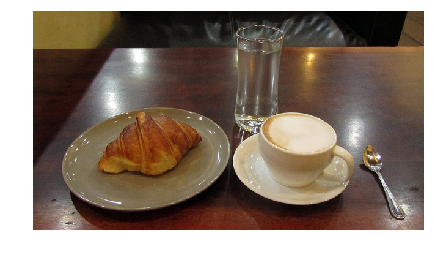

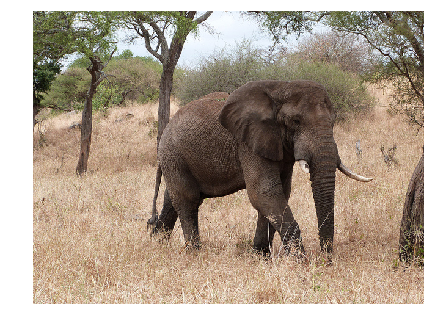

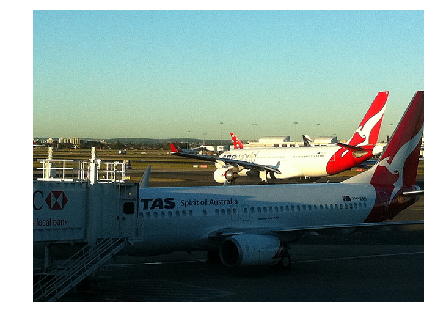

...

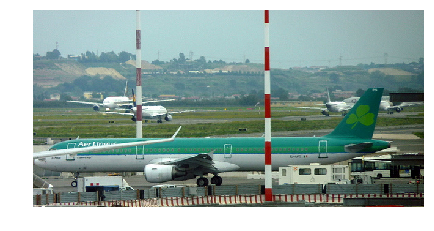

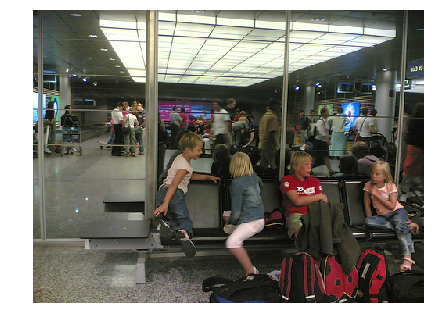

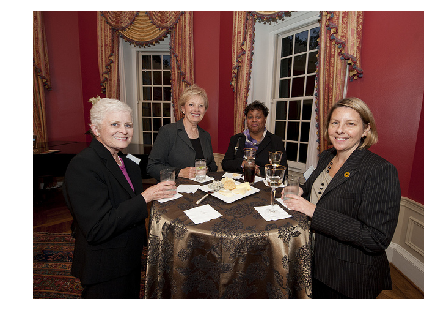

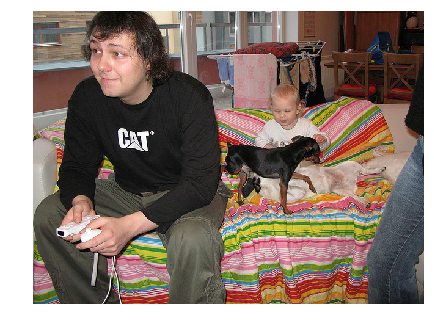

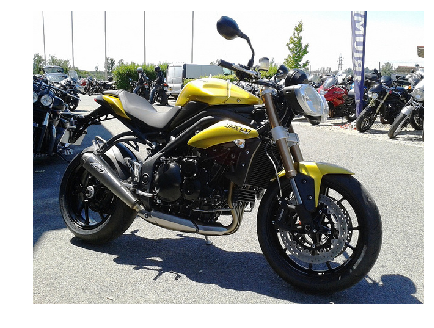

In [79]:
zf = zipfile.ZipFile("val2014_sample.zip")
all_files = set(val_img_fns)
found_files = list(filter(lambda x: x.filename.rsplit("/")[-1] in all_files, zf.filelist))
for i in range(64):
    example = zf.read(found_files[i])
    img = utils.decode_image_from_buf(example)
    fig = plt.figure(figsize=(7,7))
    plt.grid("off")
    plt.axis("off")
    plt.imshow(img)
    plt.show()

<ZipInfo filename='val2014/COCO_val2014_000000130234.jpg' filemode='-rw-rw-r--' file_size=303961>


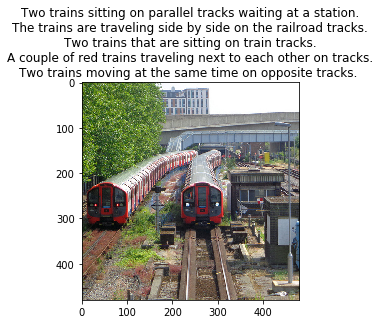

In [89]:
test_fn = val_img_fns[0]
zf = zipfile.ZipFile("val2014_sample.zip")
captions_by_file = dict(zip(val_img_fns, val_captions))
all_files = set(val_img_fns)
# choose the last item after split. 
found_files = list(filter(lambda x: x.filename.rsplit("/")[-1] in all_files, zf.filelist))
example = found_files[0]
print(example)
# decode the image from buf.  
img = utils.decode_image_from_buf(zf.read(example))
plt.imshow(utils.image_center_crop(img))
plt.title("\n".join(captions_by_file[example.filename.rsplit("/")[-1]]))
plt.show()

In [95]:
for i, fn in enumerate(val_img_fns):
    if fn == "COCO_val2014_000000130234.jpg":
        print(i)

71


In [143]:
# check that it's learnt something, outputs accuracy of next word prediction (should be around 0.5)
from sklearn.metrics import accuracy_score, log_loss

def decode_sentence(sentence_indices):
    return " ".join(list(map(vocab_inverse.get, sentence_indices)))
 
    
def check_after_training(n_examples):
    #fd = generate_batch(train_img_embeds, train_captions_indexed, batch_size) # feed dict 
    fd = generate_batch_of_first_64_imgs(val_img_embeds, val_captions_indexed, batch_size)
    logits = decoder.flat_token_logits.eval(fd)
    truth = decoder.flat_ground_truth.eval(fd)
    mask = decoder.flat_loss_mask.eval(fd).astype(bool)
    print("Loss:", decoder.loss.eval(fd))
    print("Accuracy:", accuracy_score(logits.argmax(axis=1)[mask], truth[mask]))
    for example_idx in range(n_examples):
        print("Example", example_idx)
        print("Predicted:", decode_sentence(logits.argmax(axis=1).reshape((batch_size, -1))[example_idx]))
        print("Truth:", decode_sentence(truth.reshape((batch_size, -1))[example_idx]))
        print("")

check_after_training(64)

Loss: 2.88011
Accuracy: 0.43178807947
Example 0
Predicted: a bananas are are sitting to a cup of coffee #END# #END# #END# #END# #END# #END# #END# #END# #END# #END#
Truth: some bananas that are next to a cup of coffee #END# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD#

Example 1
Predicted: a are a suitcase on a suitcases on #END# #END# #END# #END# #END# #END# #END# #END# #END# #END# #END# #END#
Truth: there is a suitcase and smaller bags #END# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD#

Example 2
Predicted: a of a clock with a in them a #END# #END# #END# #END# #END# #END# #END# #END# #END# #END# #END#
Truth: entryway to a building with people entering and exiting #END# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD#

Example 3
Predicted: a and a frisbee in man in the the frisbee #END# #END# #END# #END# #END# #END# #END# #END# #END# #END#
Truth: mom gives her daughter a lesson in using her baseball glove #END# #PAD# #PAD# #PAD# #PAD# #PAD

Predicted: a birds are standing in a water #END# #END# #END# #END# #END# #END# #END# #END# #END# #END# #END# #END# #END#
Truth: some birds are standing near some water outside #END# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD#

Example 43
Predicted: a is is eating a a cell day #END# to a mouth #END# #END# #END# #END# #END# #END# #END# #END#
Truth: this man is outside on a sunny day next to his car #END# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD#

Example 44
Predicted: a sitting on on a refrigerator on a cat remote #END# it wall #END# #END# #END# #END# #END# #END# #END#
Truth: cat #UNK# sitting on a suitcase with a closed kennel against the wall #END# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD#

Example 45
Predicted: a bowl of has a food on it #END# #END# #END# #END# #END# #END# #END# #END# #END# #END# #END# #END#
Truth: a bowl that has some soup in it #END# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD# #PAD#

Example 46
Predicted: a teddy holding on a teddy wi

In [35]:
# val_train_found_indexes = []
# counter = 0
# def full_comparison():
#     for val_img_idx, val_img in enumerate(val_captions_indexed.tolist()):
#         for val_caption_idx, val_caption in enumerate(val_img):
#             for train_img_idx, train_img in enumerate(train_captions_indexed.tolist()):
#                 if val_caption in train_img:
#                     counter += 1
#                     val_train_found_indexes.append([[val_img_idx, val_caption_idx], [train_img_idx]])
#     print("Total number of mathces: {}".format(counter))
#     print("A slice from val_train_found_indexes: {}".format(val_train_found_indexes[:5]))
                    
# def caption_comparison():
#     for val_img_idx, val_img in enumerate(val_captions_indexed.tolist()):
#         for train_img_idx, train_img in enumerate(train_captions_indexed.tolist()):
#             if val_img == train_img:
#                 print("Found match!")

# caption_comparison()
# caption_comparison didn't output anything, therefore there's no the same images in the train and in
# the validation set. 

In [56]:
# Problem: Model has too low val score.
# Notes: 
# 1. The accuracy score is about 1
# 2. Model has weird predictions in the place, where the #PAD token has to be. 
# Ans: it seems that we don't take into account the predictions of the model after PAD token, as it doesn't
# make sense. 

# Solutions:
# 1. The very first solution I suggest is to train ~1-2 epochs and try it again.
# Ans: Didn't work.

# 2. Investigate the validation set. Does it have the same values as the training set?
# Ans: No, it doesn't

# 3. Investigate the regularization term in the model. Does my model has it in the Keras defined layers? 

# 4. Probably, this is connected with the way of calculation train and val loss. Does your mask and formula 
# for computing the loss is right? 
# Ans: probably, my loss is not right. I have to take the tf.reduce_mean only on NOT PAD tokens. 

# 5. The difference in the train_loss and val_loss is caused by the nature ofo computing the loss. We take just 
# the average, so train_loss consists of the big losses at the start and small losses at the end. The val_loss
# is STARTING with the small losses. But well, the real loss on the batch is approx. the same in the last
# train_loss and the val_loss.

# 6. The suggestion that the model is training on the validation set is also wrong as the whole list of 100
# losses is approx. the same. The last hypothesis that I have is my model is just too good for the coursera
# assignment.

# TODO: fix the loss function. It didn't pass the test

2915

In [ ]:
# QUESTIONS:
# 1. How does saver works? 
# 2. How does optimizer.minimize tunes the weights of the model? 

In [144]:
# save last graph weights to file!
saver.save(s, get_checkpoint_path())

'/root/intro_to_dl/week6/weights'

# Applying model

Here we construct a graph for our final model.

It will work as follows:
- take an image as an input and embed it
- condition lstm on that embedding
- predict the next token given a START input token
- use predicted token as an input at next time step
- iterate until you predict an END token

### *Problem: The model is not working on the next examples. Although, it works fine on the validation set*
1. Hypothesis:
Probably, the cause is in the final_model or in the generate_caption. try to see the output of the 
new_probs, new_logits.  
Q: Don't I have to flatten the values first?  
A: No, I don't as I have just a one image.  


2. Hypothesis:
Probably, the model is not conditioning on the input images. Try to see the output of the encoder(image)  
Ans: It's wrong: the img embeds are different for each image.  


3. Hypothesis:
Try to train the model a little bit longer. Probably it will help. 
But during training I don't use any of the images as the initial state of the model. Probably, my model is just
doesn't know how to condition on the image, and that's why it predicts a mess. Does my model uses the images 
during training?  
Ans:
Wrong. The model is feeded with the image embeddings during training.  


4. Hypothesis:
I use different images in the show_valid_example  
Ans: Wrong. The images are the same.  


5. Hypothesis:
The model somehow is considering that it has to predict something after the token #END. Like, it's predicting the 
PAD tokens.  
On the 0 element (with the trains) it performs okay during check_after_training and it becoms broken during 
show_valid_example on this same image. Therefore, probably the problem is in the **final_model** or in the 
**generate_caption**   
Does the final_model even conditions on the image? I think yes


6. Hypothesis:
My encoder returns very weird image embedding: they are less than 0. Check if the **encoder** code is legit.  
Ans: it was not the img embeds, it was the h, my image embedding and the given image embedding are the same. 


7. Notes:
Overall: the model is conditioning on the image; if I make the last token caption[0] it starts to predict a little
bit different. Cleaning the data and the model and training it from scratch does not help.

In [145]:
class final_model:
    # CNN encoder
    encoder, preprocess_for_model = get_cnn_encoder()
    saver.restore(s, get_checkpoint_path())  # keras applications corrupt our graph, so we restore trained weights
    
    # containers for current lstm state
    lstm_c = tf.Variable(tf.zeros([1, LSTM_UNITS]), name="cell")
    lstm_h = tf.Variable(tf.zeros([1, LSTM_UNITS]), name="hidden")

    # input images
    input_images = tf.placeholder('float32', [1, IMG_SIZE, IMG_SIZE, 3], name='images')

    # get image embeddings
    img_embeds = encoder(input_images)
    print("img embeds", img_embeds.shape)

    # initialize lstm state conditioned on image
    print("img to bottleneck", decoder.img_embed_to_bottleneck(img_embeds).shape)
    init_c = init_h = decoder.img_embed_bottleneck_to_h0(decoder.img_embed_to_bottleneck(img_embeds))
    init_lstm = tf.assign(lstm_c, init_c), tf.assign(lstm_h, init_h)
    
    # current word index
    current_word = tf.placeholder('int32', [1], name='current_input')

    # embedding for current word
    word_embed = decoder.word_embed(current_word)

    # apply lstm cell, get new lstm states
    lstm_output = decoder.lstm(word_embed, tf.nn.rnn_cell.LSTMStateTuple(lstm_c, lstm_h))
    print("LSTM output: ", lstm_output)
    
    new_c, new_h = lstm_output[1]
    hidden_states = lstm_output[0]
    #lstm_state = tf.nn.rnn_cell.LSTMStateTuple(lstm_c, lstm_h)
    #new_c = new_h = hidden_states = tf.nn.dynamic_rnn(cell=decoder.lstm, inputs=word_embed, initial_state=lstm_state)
    
    #token_logits = decoder.flat_token_logits()

    # compute logits for next token
    new_logits = decoder.token_logits(decoder.token_logits_bottleneck(new_h))
    print("new_logits: ", new_logits, new_logits.shape)
    # compute probabilities for next token
    new_probs = tf.nn.softmax(new_logits)
    print("new_probs", new_probs, new_probs.shape )

    # `one_step` outputs probabilities of next token and updates lstm hidden state
    one_step = new_probs, tf.assign(lstm_c, new_c), tf.assign(lstm_h, new_h)

INFO:tensorflow:Restoring parameters from /root/intro_to_dl/week6/weights
img embeds (1, 2048)
img to bottleneck (1, 120)
LSTM output:  (<tf.Tensor 'rnn/while/rnn/lstm_cell/lstm_cell_2/mul_2:0' shape=(1, 300) dtype=float32>, LSTMStateTuple(c=<tf.Tensor 'rnn/while/rnn/lstm_cell/lstm_cell_2/add_1:0' shape=(1, 300) dtype=float32>, h=<tf.Tensor 'rnn/while/rnn/lstm_cell/lstm_cell_2/mul_2:0' shape=(1, 300) dtype=float32>))
new_logits:  Tensor("dense_4/BiasAdd_1:0", shape=(1, 8769), dtype=float32) (1, 8769)
new_probs Tensor("Softmax:0", shape=(1, 8769), dtype=float32) (1, 8769)


In [146]:
vocab[PAD]

1

In [147]:
res = []
# this is an actual prediction loop
def generate_caption(image, t=1, sample=False, max_len=20):
    """
    Generate caption for given image.
    if `sample` is True, we will sample next token from predicted probability distribution.
    `t` is a temperature during that sampling,
        higher `t` causes more uniform-like distribution = more chaos.
    """
    # condition lstm on the image
    s.run(final_model.init_lstm, 
          {final_model.input_images: [image]})
    
    #s_res = s.run(final_model.img_embeds, {final_model.input_images: [image]})
    
    #global res
    #res.append(s_res[0])
    #print("img embedding array: ", res[0])
    print("img embedding", final_model.img_embeds)
    
    # current caption
    # start with only START token
    caption = [vocab[START]]
    
    for _ in range(max_len):
        next_word_probs = s.run(final_model.one_step, 
                                {final_model.current_word: [caption[-1]]})[0]
        # print("next_word_probs", np.argmax(next_word_probs))
        next_word_probs = next_word_probs.ravel()
        
        # apply temperature
        next_word_probs = next_word_probs**(1/t) / np.sum(next_word_probs**(1/t))
    
        # What the sampling does? 
        if sample:
            next_word = np.random.choice(range(len(vocab)), p=next_word_probs)
        else:
            next_word = np.argmax(next_word_probs)
    
        # print(caption[-1])
        caption.append(next_word)
        if next_word == vocab[END]:
            break
       
    return list(map(vocab_inverse.get, caption))

img embedding Tensor("model_1/global_average_pooling2d_1/Mean:0", shape=(1, 2048), dtype=float32)
a train is pulling into a station in a train station


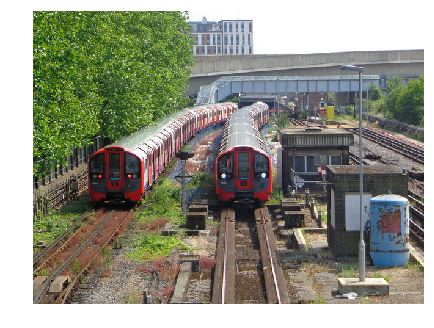

In [148]:
# look at validation prediction example
def apply_model_to_image_raw_bytes(raw):
    img = utils.decode_image_from_buf(raw)
    fig = plt.figure(figsize=(7, 7))
    plt.grid('off')
    plt.axis('off')
    plt.imshow(img)
    img = utils.crop_and_preprocess(img, (IMG_SIZE, IMG_SIZE), final_model.preprocess_for_model)
    print(' '.join(generate_caption(img)[1:-1]))
    plt.show()

def show_valid_example(val_img_fns, example_idx=0):
    zf = zipfile.ZipFile("val2014_sample.zip")
    all_files = set(val_img_fns)
    found_files = list(filter(lambda x: x.filename.rsplit("/")[-1] in all_files, zf.filelist))
    example = found_files[example_idx]
    apply_model_to_image_raw_bytes(zf.read(example))
    
show_valid_example(val_img_fns, example_idx=0)

In [193]:
val_img_embeds[71]

array([ 0.73624378,  0.50332028,  0.08133171, ...,  0.13949251,
        0.48373249,  0.03333943], dtype=float32)

img embedding Tensor("model_1/global_average_pooling2d_1/Mean:0", shape=(1, 2048), dtype=float32)
#START# there there close close close close close close close close close close close close close close close close


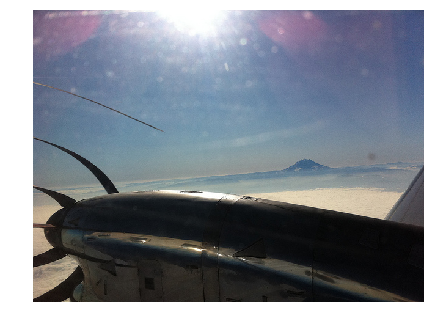

img embedding Tensor("model_1/global_average_pooling2d_1/Mean:0", shape=(1, 2048), dtype=float32)
#START# there there there close close close close close close close close close close close close close close close


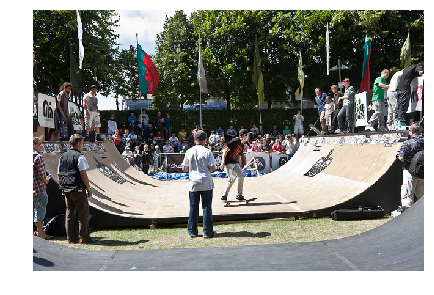

img embedding Tensor("model_1/global_average_pooling2d_1/Mean:0", shape=(1, 2048), dtype=float32)
#START# many many many many many many many many old old old old old old old old old old


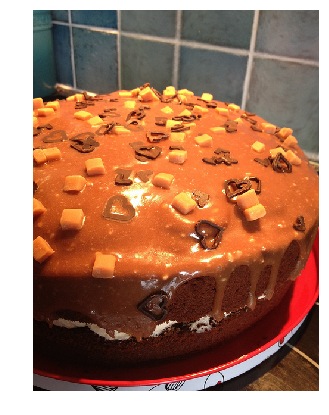

img embedding Tensor("model_1/global_average_pooling2d_1/Mean:0", shape=(1, 2048), dtype=float32)
#START# many many many many many many many old old old old old old old old old old old


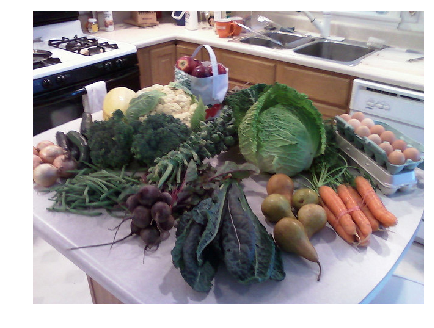

img embedding Tensor("model_1/global_average_pooling2d_1/Mean:0", shape=(1, 2048), dtype=float32)
#START# there there close close close close close close close close close close close close close close close close


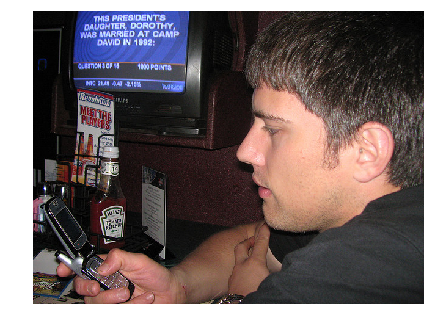

img embedding Tensor("model_1/global_average_pooling2d_1/Mean:0", shape=(1, 2048), dtype=float32)
#START# many many many many many many many many old old old old old old old old old old


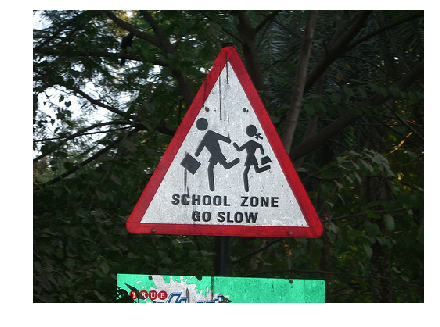

img embedding Tensor("model_1/global_average_pooling2d_1/Mean:0", shape=(1, 2048), dtype=float32)
#START# there there close close close close close close close close close close close close close close close close


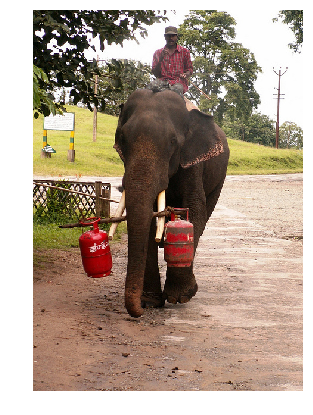

img embedding Tensor("model_1/global_average_pooling2d_1/Mean:0", shape=(1, 2048), dtype=float32)
#START# many many many many many many many old old old old old old old old old old old


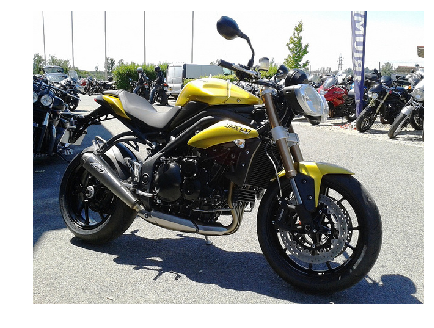

img embedding Tensor("model_1/global_average_pooling2d_1/Mean:0", shape=(1, 2048), dtype=float32)
#START# there there close close close close close close close close close close close close close close close close


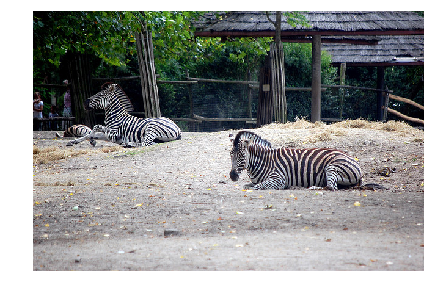

img embedding Tensor("model_1/global_average_pooling2d_1/Mean:0", shape=(1, 2048), dtype=float32)
#START# there there there close close close close close close close close close close close close close close close


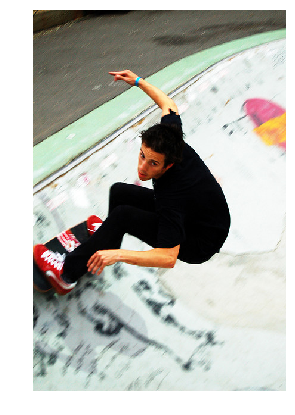

In [131]:
# sample more images from validation
for idx in np.random.choice(range(len(zipfile.ZipFile("val2014_sample.zip").filelist) - 1), 10):
    show_valid_example(val_img_fns, example_idx=idx)
    time.sleep(1)

You can download any image from the Internet and appply your model to it!

In [ ]:
download_utils.download_file(
    "http://www.bijouxandbits.com/wp-content/uploads/2016/06/portal-cake-10.jpg",
    "portal-cake-10.jpg"
)

In [ ]:
apply_model_to_image_raw_bytes(open("portal-cake-10.jpg", "rb").read())

Now it's time to find 10 examples where your model works good and 10 examples where it fails! 

You can use images from validation set as follows:
```python
show_valid_example(val_img_fns, example_idx=...)
```

You can use images from the Internet as follows:
```python
! wget ...
apply_model_to_image_raw_bytes(open("...", "rb").read())
```

If you use these functions, the output will be embedded into your notebook and will be visible during peer review!

When you're done, download your noteboook using "File" -> "Download as" -> "Notebook" and prepare that file for peer review!

In [ ]:
### YOUR EXAMPLES HERE ###

That's it! 

Congratulations, you've trained your image captioning model and now can produce captions for any picture from the  Internet!